In [1]:
%matplotlib inline
import matplotlib
matplotlib.rcParams.update( {'font.size': 22})
from matplotlib import pyplot as plt
import numpy as np
import importlib
import copy

In [2]:
from scipy import stats

In [3]:
import kinetic_titration as ktit
importlib.reload(ktit)
import data_cleanup as dc
from scipy.signal import savgol_filter
from scipy.interpolate import interp1d

In [4]:
Rt, tCinject = ktit.loadSPR( "data/ASPIRE_Her1short_Her1aza_50mMNaCl_04132021 Full Assay.txt", "data/ASPIRE_Her1short_Her1aza_50mMNaCl_04132021 concs.txt")

In [5]:
Rt, outliers = ktit.remove_RU_outliers( Rt, zcut = 1.25)
tinject = 120

In [6]:
times = Rt[:,0]

In [7]:
def plot_SPR_fit( Rt, tCinject, tinject, params, model='2C'):
    parmrep = [ 
            [ '$R_\mathrm{max}$', '%.3g $\pm$ %.3g' % (params['Rmax'].value, params['Rmax'].stderr) ],
            [ '$k_a$ (nM$^{-1}\cdot$s$^{-1}$)', '%.3g $\pm$ %.3g' % (params['ka'].value, params['ka'].stderr) ],
            [ '$k_d$ (s$^{-1}$)', '%.3g $\pm$ %.3g' % (params['kd'].value, params['kd'].stderr)] ]
    
    # Two-compartment model
    if model=='2C':
        times, Rtp = ktit.calc_response_curve( Rt[:,0], tCinject, tinject,
                                               params['Rmax'].value, params['ka'].value,
                                               params['kd'].value, params['kM'].value)
        parmrep.append([ '$k_M$ (s$^{-1}$)', '%.3g $\pm$ %.3g' % (params['kM'].value, params['kM'].stderr) ])
    # Rapid mixing model
    elif model=='RM':
        times, Rtp = ktit.calc_response_curve_rapid_mixing( Rt[:,0], tCinject, tinject,
                                                          params['Rmax'].value, params['ka'].value,
                                                          params['kd'].value)
    else:
        return
    
    Ropen = params['Rmax'].value - Rtp

    x = Rt[:,0]
    y = Rt[:,1]

    # plotting functions
    fig, ax = plt.subplots()
    Rt_main = ax.plot( x, y, '.') 
    ax.plot( times, Rtp, '-')
    ax.plot( times, Ropen, '--', label='R$_\mathrm{open}$')
    
    ax.set_xlabel( 'Time (s)')
    ax.set_ylabel( 'RU')
    #ax.set_yscale( 'log')

    ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))

    color2 = 'red'
    ax2 = ax.twinx()
    times = np.linspace( Rt[0,0], Rt[-1,0], 1000)
    Ct = np.array( [ ktit.CliquidAtTime( t, tCinject, tinject) for t in times ])
    ax2.plot( times, Ct, color=color2)
    ax2.set_ylabel( 'Concentration (nM)')
    ax2.spines['right'].set_color( color2)
    ax2.tick_params( axis='y', colors=color2)
    ax2.yaxis.label.set_color( color2)
    
    ax.table( cellText=parmrep,
            loc='top')
    fig.subplots_adjust( top=1.8, right=1.5)

    return fig, ax

In [8]:
results = ktit.fit_SPR( Rt, tCinject, tinject, Rmax=100., ka=1.e-4, kd=1.e-3, kM=20.)
results

In [9]:
resultsRM = ktit.fit_SPR_rapid_mixing( Rt, tCinject, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
# kinetic parameters before processing
resultsRM

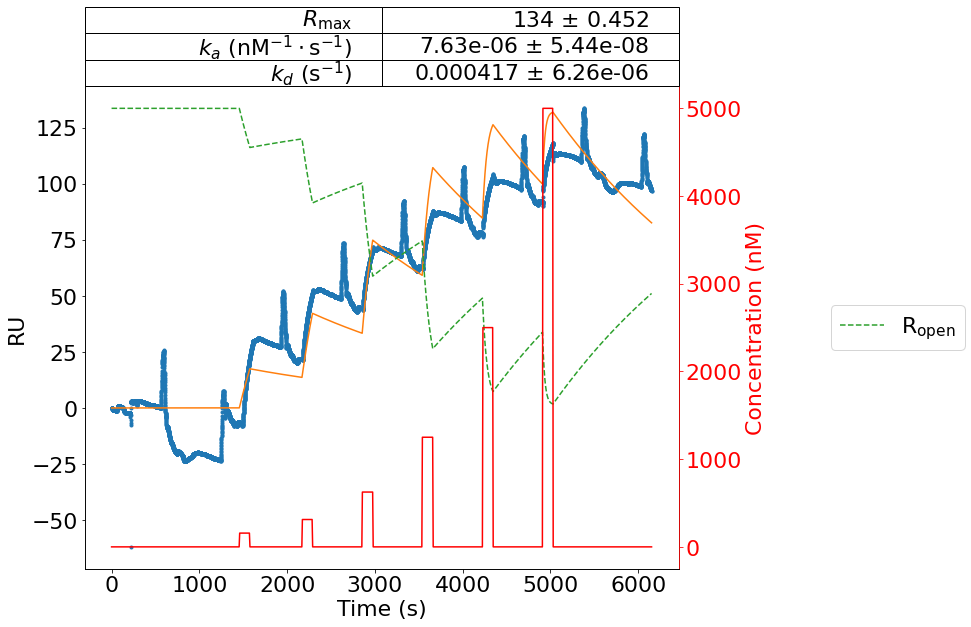

In [10]:
_ = plot_SPR_fit( Rt, tCinject, tinject, resultsRM.params, model='RM')

In [12]:
Rt_smoothed = copy.deepcopy(Rt)
Rt_smoothed[:,1] = dc.IIR_smoothing(Rt_smoothed[:,0], Rt_smoothed[:,1], 150)
#_ = dc.SVG_filter(Rt_smoothed[:,0], Rt_smoothed[:,1], win_len=59, polyorder=5)

interactive(children=(IntSlider(value=150, description='IIR Coefficient: ', max=500, min=1), Output()), _dom_c…

/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in less
  & (np.greater(y, thres))
/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in greater
  & (np.greater(y, thres))


(0.0, 121.64661485421877)

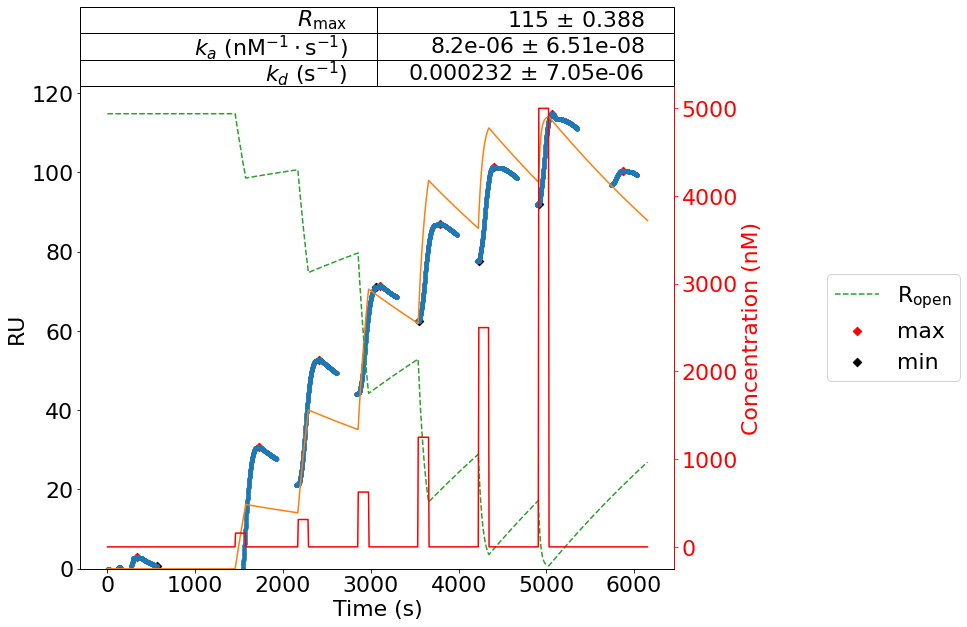

In [13]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt_smoothed[:,1], height = 0, distance = 100, prominence = 5, width = 20, rel_height = 1)

# removing spikes based on the peaks located
Rt_smoothed[:,1] = dc.spike_removal(Rt_smoothed[:,1], peaks, thresh_v = -5, thresh_dv = 0, min_size = 75)

# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt_smoothed[:,1], mask=np.isnan(Rt_smoothed[:,1]))
indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt_smoothed), tCinject, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
fig, ax = plot_SPR_fit( Rt_smoothed, tCinject, tinject, resultsRM.params, model='RM')

# showing peakutils maximas and minimas
ax.scatter( times[indexes], Rt_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax.scatter( times[neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min') 
ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))
ax.set_ylim(0)

In [14]:
# kinetic parameters after processing
resultsRM

In [15]:
Rmax, ka, kd = resultsRM.params['Rmax'].value, resultsRM.params['ka'].value, resultsRM.params['kd'].value
results = ktit.fit_SPR( Rt, tCinject, tinject, Rmax=Rmax, ka=0.5*ka, kd=kd, kM=10)

In [16]:
results # prior to data cleanup of Rt values

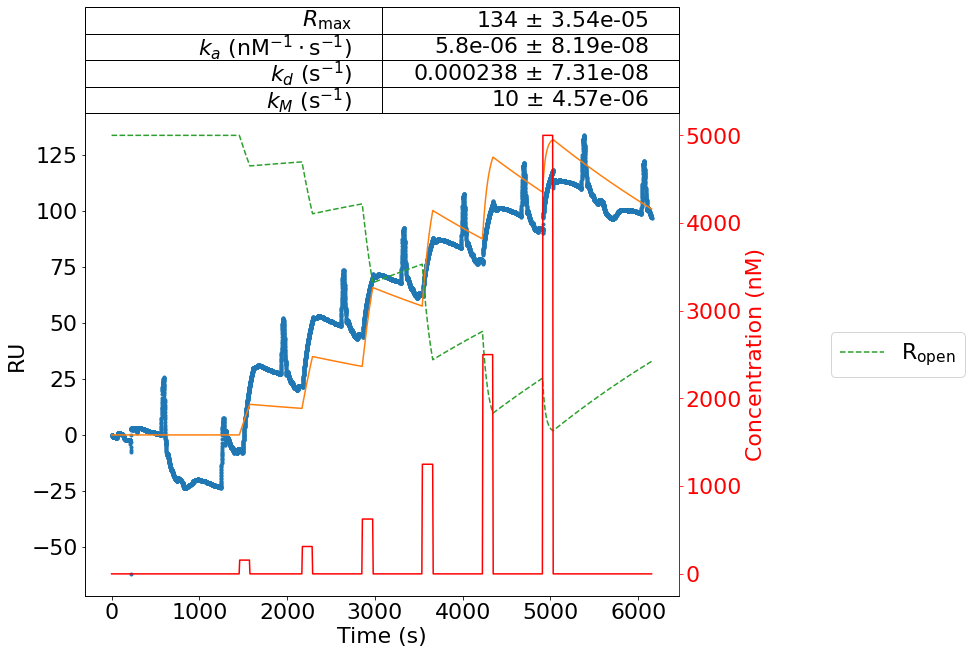

In [17]:
_ = plot_SPR_fit( Rt, tCinject, tinject, results.params, model='2C')

In [18]:
Rt_smoothed = copy.deepcopy(Rt)
Rt_smoothed[:,1] = dc.IIR_smoothing(Rt_smoothed[:,0], Rt_smoothed[:,1], 150)

interactive(children=(IntSlider(value=150, description='IIR Coefficient: ', max=500, min=1), Output()), _dom_c…

/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in less
  & (np.greater(y, thres))
/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in greater
  & (np.greater(y, thres))


(0.0, 121.64661603168112)

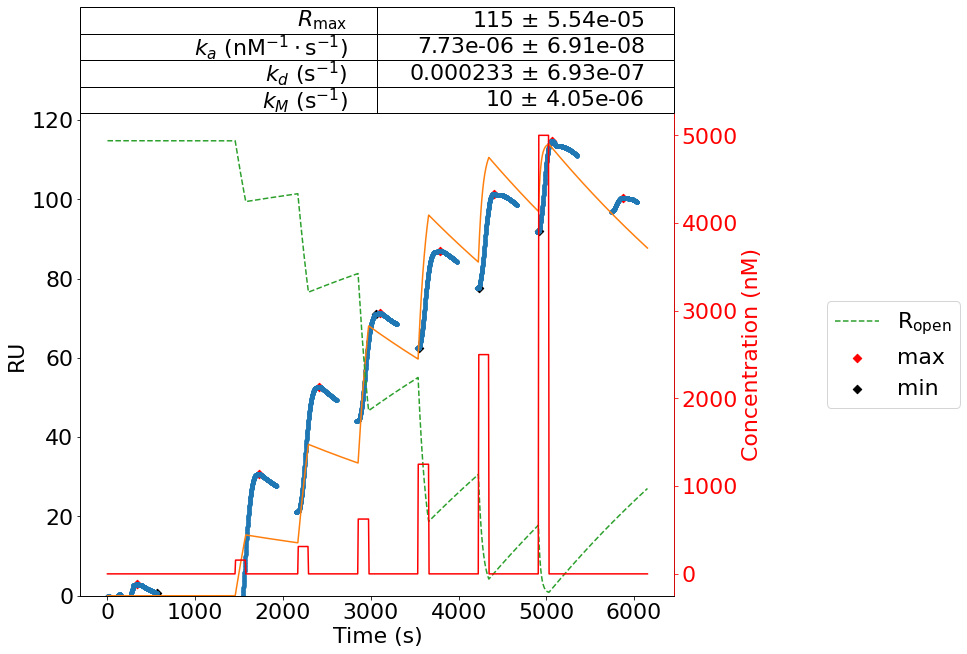

In [19]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt_smoothed[:,1], height = 0, distance = 100, prominence = 5, width = 20, rel_height = 1)

# removing spikes based on the peaks located
Rt_smoothed[:,1] = dc.spike_removal(Rt_smoothed[:,1], peaks, thresh_v = -5, thresh_dv = 0, min_size = 75)

# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt_smoothed[:,1], mask=np.isnan(Rt_smoothed[:,1]))
indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

results = ktit.fit_SPR( np.ma.masked_invalid(Rt_smoothed), tCinject, tinject, Rmax=Rmax, ka=0.5*ka, kd=kd, kM=10)
fig, ax = plot_SPR_fit( Rt_smoothed, tCinject, tinject, results.params, model='2C')

# showing peakutils maximas and minimas
ax.scatter( times[indexes], Rt_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax.scatter( times[neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min') 
ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))
ax.set_ylim(0)

In [20]:
results # after removal of data spikes

In [21]:
# poor experimental dataset
data = np.loadtxt( "data/EGFR_WT_39599_05_19_2021.txt", skiprows = 16)
tC = np.loadtxt("data/EGFR_WT_tC_39599_05_19_2021.txt", skiprows = 1)

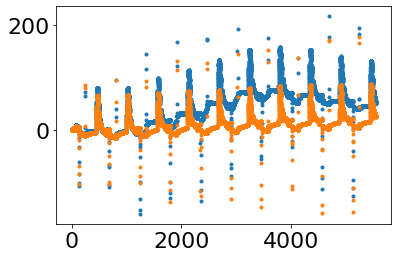

In [22]:
plt.plot(data[:,0], data[:,1], '.')
plt.plot(data[:,2], data[:,3], '.')

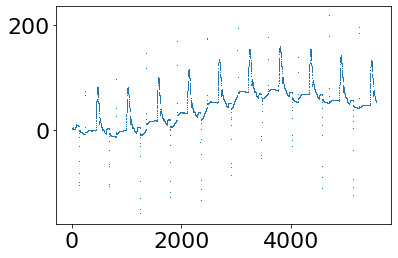

In [23]:
plt.plot(data[:,0], data[:,1], ',')

In [24]:
Rt = data[:,:2]
Rt, outliers = ktit.remove_RU_outliers( Rt, zcut = 1.25)
tinject = 120
resultsRM = ktit.fit_SPR_rapid_mixing( Rt, tC, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results = ktit.fit_SPR( Rt, tC, tinject, Rmax=resultsRM.params['Rmax'].value, ka=resultsRM.params['ka'].value, kd=resultsRM.params['kd'].value)

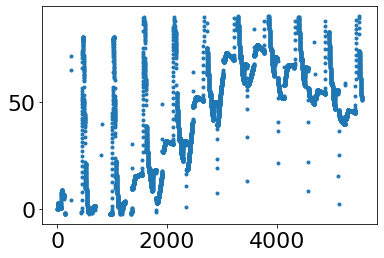

In [25]:
plt.plot( Rt[:,0], Rt[:,1], '.')

In [26]:
results # prior to data cleanup of Rt values

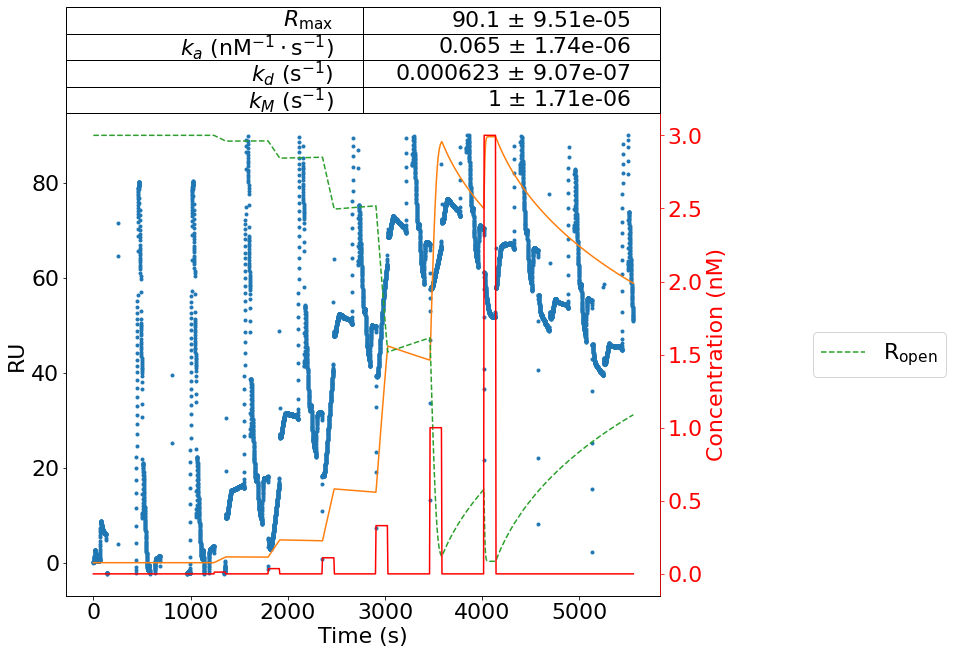

In [27]:
_ = plot_SPR_fit( Rt, tC, tinject, results.params, model='2C')

In [33]:
Rt_smoothed = copy.deepcopy(Rt)
Rt_smoothed[:,1] = dc.SVG_filter(Rt_smoothed[:,0], Rt_smoothed[:,1], 149, 3)

interactive(children=(IntSlider(value=149, description='SVG Window size: ', max=499, min=5, step=2), Output())…

/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in less
  & (np.greater(y, thres))
/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in greater
  & (np.greater(y, thres))


(0.0, 80.5599185567172)

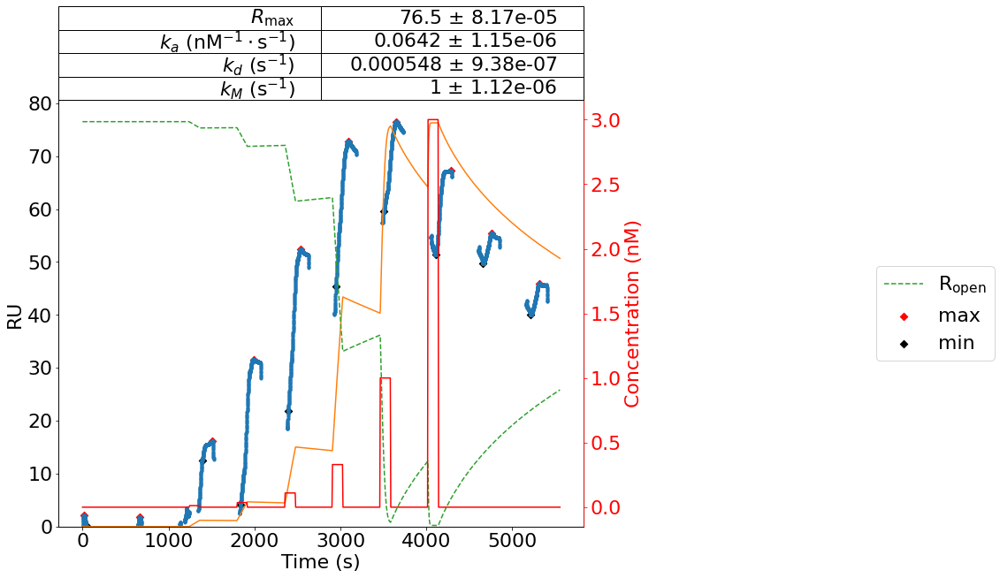

In [32]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt_smoothed[:,1], height = 0, distance = 100, prominence = 5, width = 20, rel_height = 1)

# removing spikes based on the peaks located
Rt_smoothed[:,1] = dc.spike_removal(Rt_smoothed[:,1], peaks, thresh_v = -5, thresh_dv = 0, min_size = 100)

# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt_smoothed[:,1], mask=np.isnan(Rt_smoothed[:,1]))
indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt_smoothed), tC, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results = ktit.fit_SPR( np.ma.masked_invalid(Rt_smoothed), tC, tinject, Rmax=resultsRM.params['Rmax'].value, ka=resultsRM.params['ka'].value, kd=resultsRM.params['kd'].value)
fig, ax = plot_SPR_fit( Rt_smoothed, tC, tinject, results.params, model='2C')

# showing peakutils maximas and minimas
ax.scatter( Rt_smoothed[:,0][indexes], Rt_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax.scatter( Rt_smoothed[:,0][neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min') 
ax.legend( loc='right', bbox_to_anchor = (1.8,0.5))
ax.set_ylim(0)

In [34]:
Rt1 = Rt[Rt[:,0]<3500,:]
tC1 = tC[tC[:,0]<3500,:]

In [35]:
resultsRM1 = ktit.fit_SPR_rapid_mixing( Rt1, tC1, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results1 = ktit.fit_SPR( Rt1, tC1, tinject, Rmax=resultsRM1.params['Rmax'].value, ka=resultsRM1.params['ka'].value, kd=resultsRM1.params['kd'].value)
results1 # prior to data cleanup of Rt values

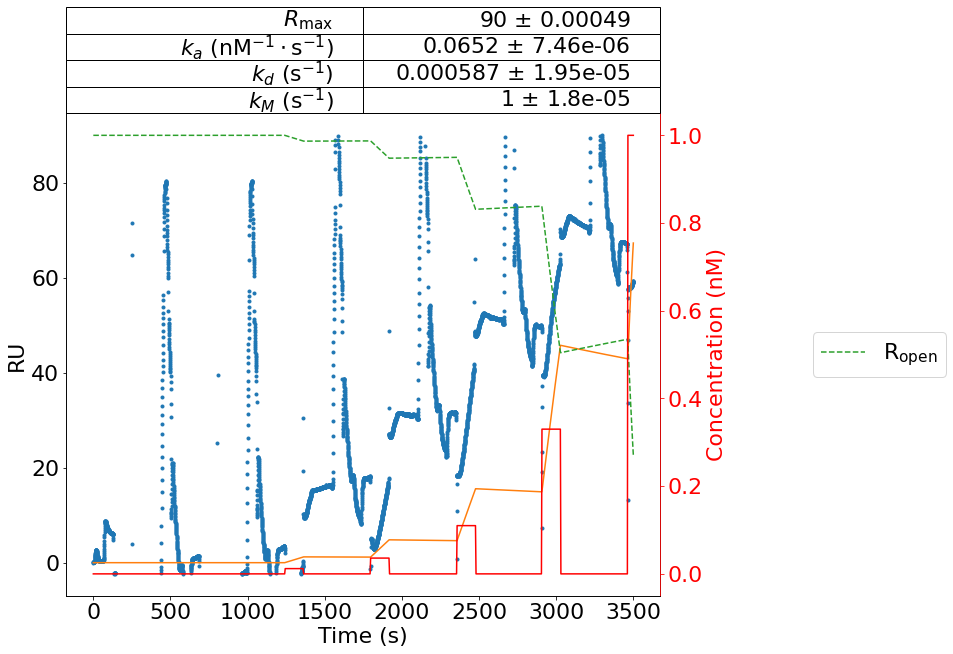

In [36]:
_ = plot_SPR_fit( Rt1, tC1, tinject, results1.params, model='2C')

In [37]:
Rt1_smoothed = copy.deepcopy(Rt1)
Rt1_smoothed[:,1] = dc.IIR_smoothing(Rt1_smoothed[:,0], Rt1_smoothed[:,1], 250)

interactive(children=(IntSlider(value=250, description='IIR Coefficient: ', max=500, min=1), Output()), _dom_c…

(0.0, 75.47406300754767)

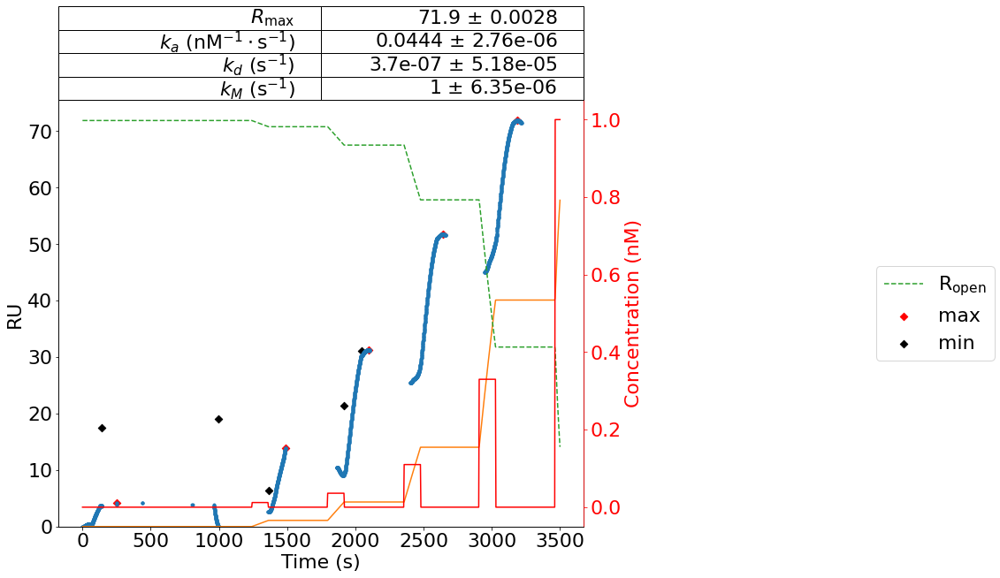

In [38]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt1_smoothed[:,1], height = 0, distance = 100, prominence = 5, width = 20, rel_height = 1)

# removing spikes based on the peaks located
Rt1_smoothed[:,1] = dc.spike_removal(Rt1_smoothed[:,1], peaks, thresh_v = -5, thresh_dv = 0, min_size = 75)

# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt1_smoothed[:,1], mask=np.isnan(Rt1_smoothed[:,1]))
indexes, props = dc.peak_detection_scipy(RU_masked, height = 0, distance = 500)
neg_indexes = dc.peakutils_detection(-1*RU_masked)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM1 = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt1_smoothed), tC1, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results1 = ktit.fit_SPR( np.ma.masked_invalid(Rt1_smoothed), tC1, tinject, Rmax=resultsRM1.params['Rmax'].value, ka=resultsRM1.params['ka'].value, kd=resultsRM1.params['kd'].value)
fig, ax = plot_SPR_fit( Rt1_smoothed, tC1, tinject, results1.params, model='2C')

# showing peakutils maximas and minimas
ax.scatter( Rt1_smoothed[:,0][indexes], props['peak_heights'], color = 'r', marker = 'D', label = 'max') 
ax.scatter( Rt_smoothed[:,0][neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min') 
ax.legend( loc='right', bbox_to_anchor = (1.8,0.5))
ax.set_ylim(0)

In [39]:
Rt = np.array( [data[:,0], data[:,1] - data[:,3]]).T

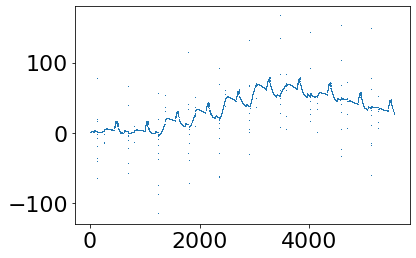

In [40]:
plt.plot(Rt[:,0], Rt[:,1], ',')

In [41]:
n = len(Rt)

In [42]:
tC[:,0]

array([ 130.,  686., 1241., 1797., 2357., 2907., 3463., 4017., 4573.,
       5127.])

In [43]:
import functools
tsyringe = 250
sel = functools.reduce( lambda x, y: np.logical_or( x, y), 
                 [ np.logical_and(Rt[:,0] >= tC[t,0], Rt[:,0]<(tC[t+1,0] - tsyringe)) for t in range(len(tC)-1) ])

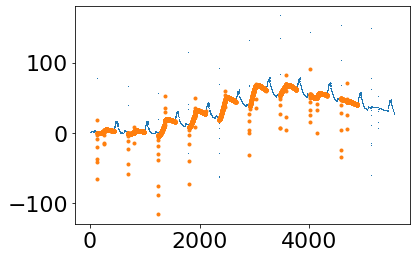

In [44]:
plt.plot( Rt[:,0], Rt[:,1], ',')
plt.plot( Rt[sel,0], Rt[sel,1], '.')

In [45]:
Rtp = Rt[sel,:]

In [46]:
tmax = 4000
Rtp, outliers = ktit.remove_RU_outliers( Rtp, zcut = 1.25)
Rt1 = Rtp[Rtp[:,0]<tmax,:]
tC1 = tC[tC[:,0]<tmax,:]
tinject = 120
resultsRM = ktit.fit_SPR_rapid_mixing( Rt1, tC1, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results = ktit.fit_SPR( Rt1, tC1, tinject, Rmax=resultsRM.params['Rmax'].value, ka=resultsRM.params['ka'].value, kd=resultsRM.params['kd'].value)

In [47]:
resultsRM # prior to data cleanup of Rt values

In [48]:
results # prior to data cleanup of Rt values

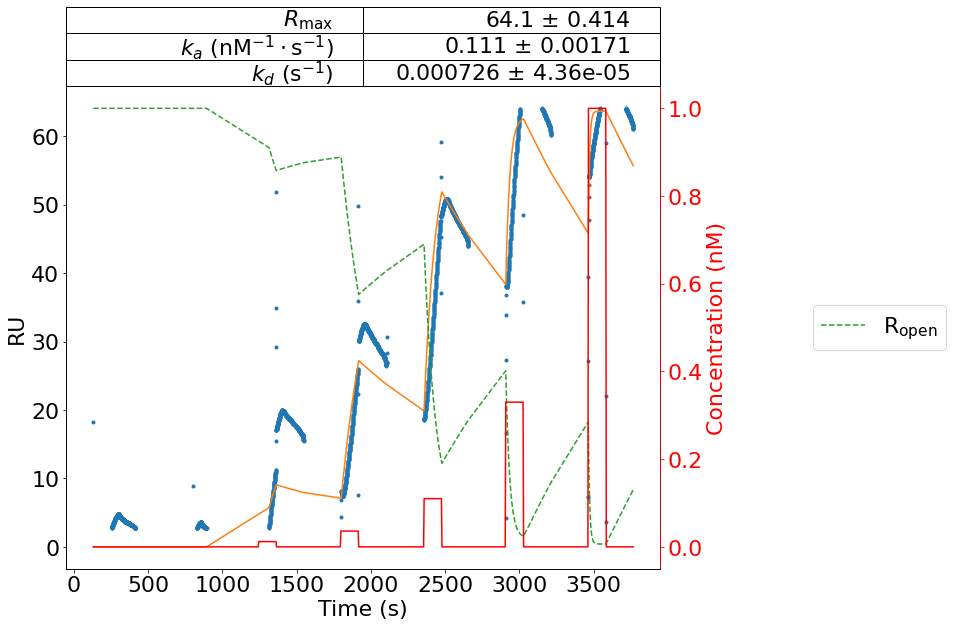

In [50]:
_ = plot_SPR_fit( Rt1, tC1, tinject, resultsRM.params, model='RM')

In [51]:
Rt1_smoothed = copy.deepcopy(Rt1)
Rt1_smoothed[:,1] = dc.IIR_smoothing(Rt1_smoothed[:,0], Rt1_smoothed[:,1], 40)

interactive(children=(IntSlider(value=40, description='IIR Coefficient: ', max=500, min=1), Output()), _dom_cl…

(0.0, 66.76238625000002)

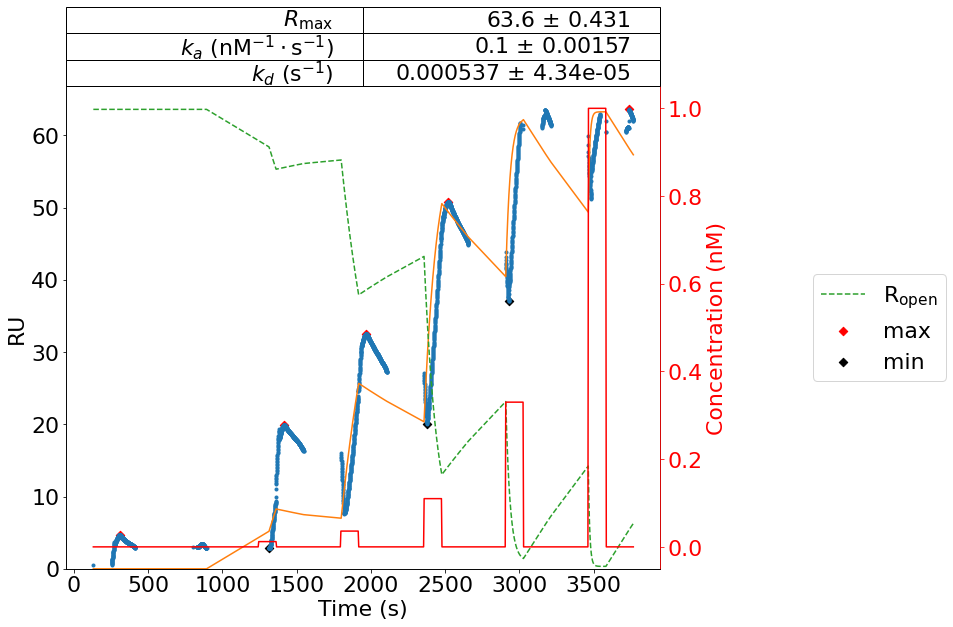

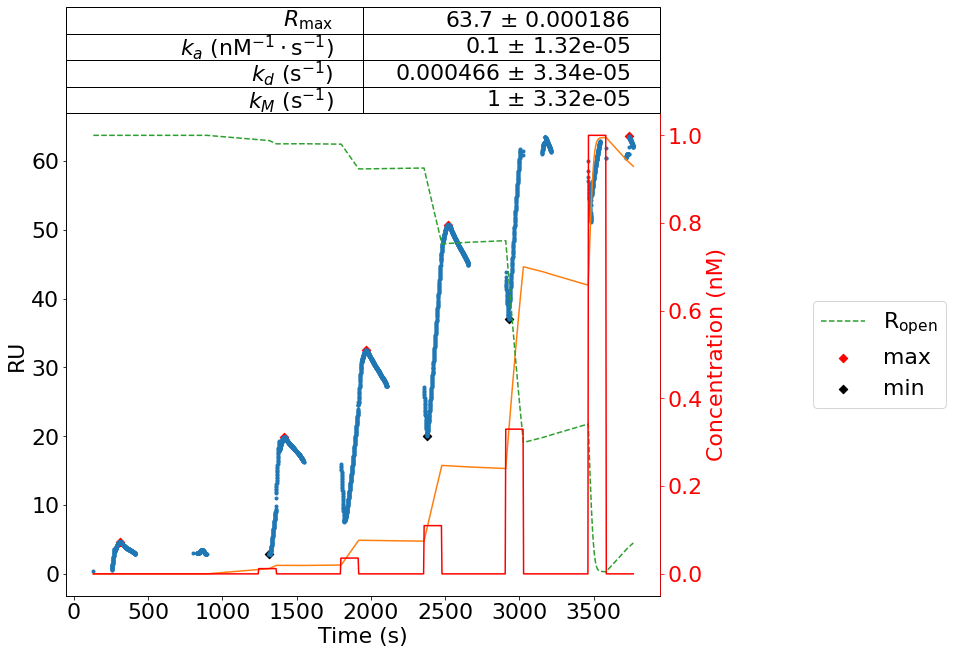

In [52]:
# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt1_smoothed[:,1], mask=np.isnan(Rt1_smoothed[:,1]))
indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM1 = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt1_smoothed), tC1, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results1 = ktit.fit_SPR( np.ma.masked_invalid(Rt1_smoothed), tC1, tinject, Rmax=resultsRM1.params['Rmax'].value, ka=resultsRM1.params['ka'].value, kd=resultsRM1.params['kd'].value)
fig, ax = plot_SPR_fit( Rt1_smoothed, tC1, tinject, resultsRM1.params, model='RM')
fig, ax1 = plot_SPR_fit( Rt1_smoothed, tC1, tinject, results1.params, model='2C')

# showing peakutils maximas and minimas
ax.scatter( Rt1_smoothed[:,0][indexes], Rt1_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax.scatter( Rt1_smoothed[:,0][neg_indexes], Rt1_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min')
ax1.scatter( Rt1_smoothed[:,0][indexes], Rt1_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax1.scatter( Rt1_smoothed[:,0][neg_indexes], Rt1_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min')
ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))
ax1.legend( loc='right', bbox_to_anchor = (1.5,0.5))
ax.set_ylim(0)

In [53]:
# poor experimental dataset
data = np.loadtxt("data/EGFR_WT_39596_05_19_2021 from Bioeval.txt", skiprows = 1)
tC = np.loadtxt("data/EGFR_WT_tC_39599_05_19_2021 from Bioeval.txt", skiprows = 1)

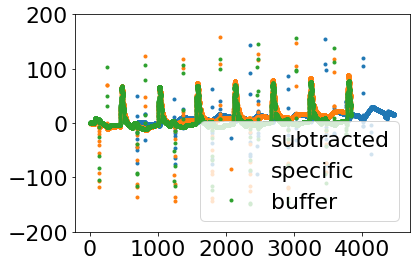

In [54]:
plt.plot(data[:,0], data[:,1], '.', label = "subtracted")
plt.plot(data[:,2], data[:,3], '.', label = "specific")
plt.plot(data[:,4], data[:,5], '.', label = "buffer")
plt.ylim(-200,200)
plt.legend(loc='best')

(-200.0, 200.0)

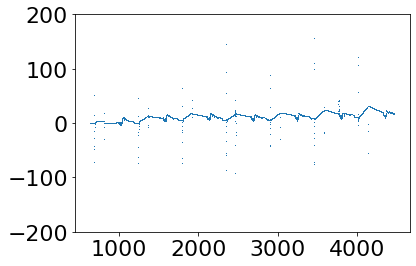

In [55]:
plt.plot(data[:,0], data[:,1], ',')
plt.ylim(-200,200)

In [75]:
Rt = data[:,:2]
Rt, outliers = ktit.remove_RU_outliers( Rt, zcut = 1.25)
tinject = 120
resultsRM = ktit.fit_SPR_rapid_mixing( Rt, tC, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results = ktit.fit_SPR( Rt, tC, tinject, Rmax=resultsRM.params['Rmax'].value, ka=resultsRM.params['ka'].value, kd=resultsRM.params['kd'].value)

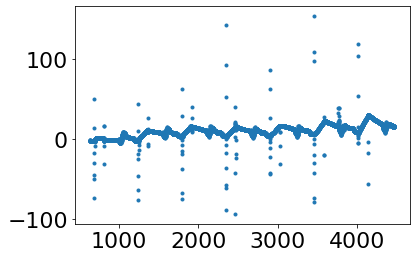

In [76]:
plt.plot(Rt[:,0], Rt[:,1], '.')

In [77]:
results # prior to data cleanup of Rt values

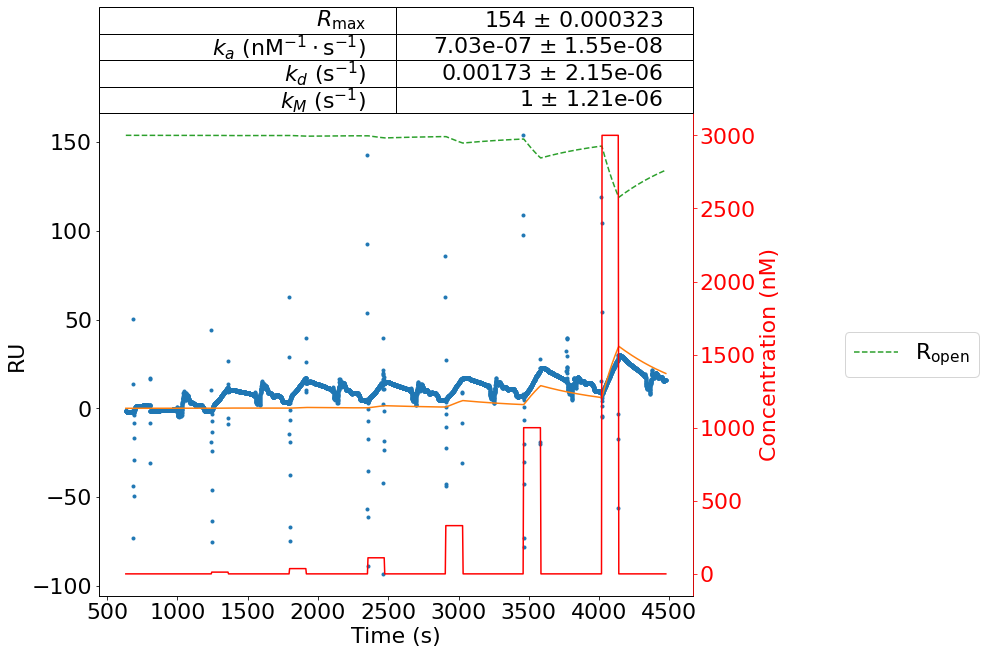

In [78]:
_ = plot_SPR_fit( Rt, tC, tinject, results.params, model='2C')

In [81]:
Rt_smoothed = copy.deepcopy(Rt)
Rt_smoothed[:,1] = dc.IIR_smoothing(Rt_smoothed[:,0],Rt_smoothed[:,1], 150)

interactive(children=(IntSlider(value=150, description='IIR Coefficient: ', max=500, min=1), Output()), _dom_c…

/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in less
  & (np.greater(y, thres))
/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in greater
  & (np.greater(y, thres))


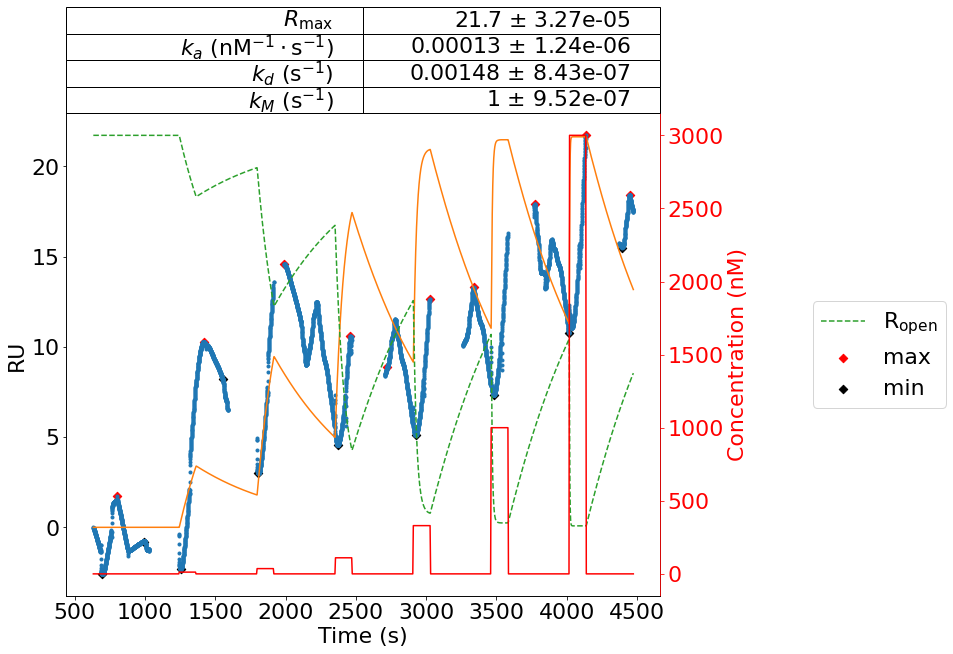

In [82]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt_smoothed[:,1], height = 0, distance = 100, prominence = 5, width = 20, rel_height = 1)

# removing spikes based on the peaks located
Rt_smoothed[:,1] = dc.spike_removal(Rt_smoothed[:,1], peaks, thresh_v = -5, thresh_dv = 0, min_size = 50)

# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt_smoothed[:,1], mask=np.isnan(Rt_smoothed[:,1]))
indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt_smoothed), tC, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results = ktit.fit_SPR( np.ma.masked_invalid(Rt_smoothed), tC, tinject, Rmax=resultsRM.params['Rmax'].value, ka=resultsRM.params['ka'].value, kd=resultsRM.params['kd'].value)
fig, ax = plot_SPR_fit( Rt_smoothed, tC, tinject, results.params, model='2C')

# showing peakutils maximas and minimas
ax.scatter( Rt_smoothed[:,0][indexes], Rt_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax.scatter( Rt_smoothed[:,0][neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min')
ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))

In [83]:
Rt1 = Rt[Rt[:,0]<3500,:]
tC1 = tC[tC[:,0]<3500,:]

In [84]:
resultsRM1 = ktit.fit_SPR_rapid_mixing( Rt1, tC1, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results1 = ktit.fit_SPR( Rt1, tC1, tinject, Rmax=resultsRM1.params['Rmax'].value, ka=resultsRM1.params['ka'].value, kd=resultsRM1.params['kd'].value)
results1 # prior to data cleanup of Rt1 values

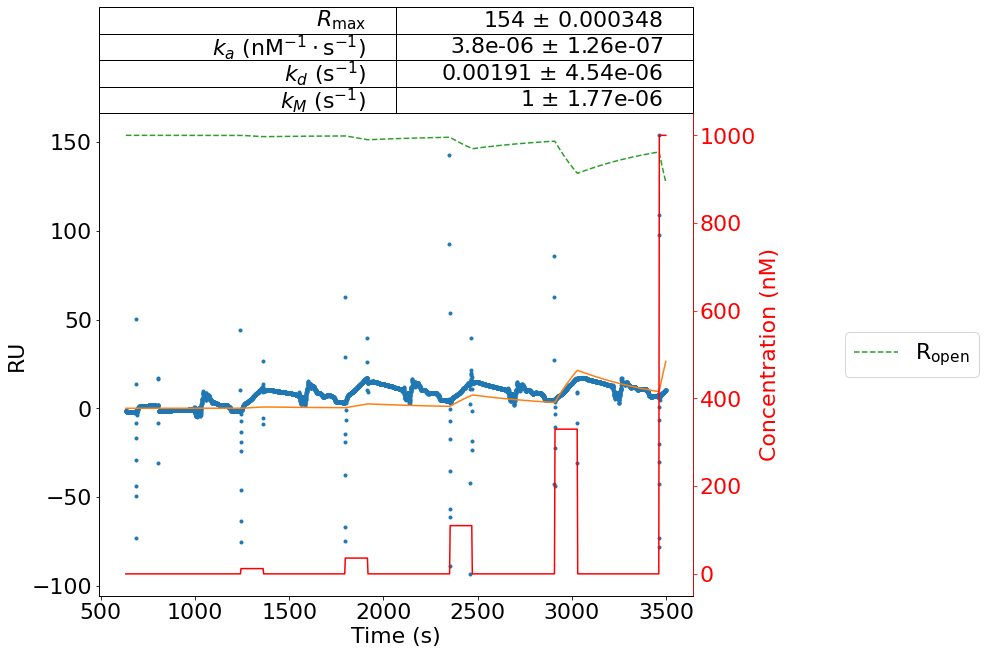

In [85]:
_ = plot_SPR_fit( Rt1, tC1, tinject, results1.params, model='2C')

In [86]:
Rt1_smoothed = copy.deepcopy(Rt1)
Rt1_smoothed[:,1] = dc.IIR_smoothing(Rt1_smoothed[:,0], Rt1_smoothed[:,1], 150)

interactive(children=(IntSlider(value=150, description='IIR Coefficient: ', max=500, min=1), Output()), _dom_c…

/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in less
  & (np.greater(y, thres))
/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in greater
  & (np.greater(y, thres))


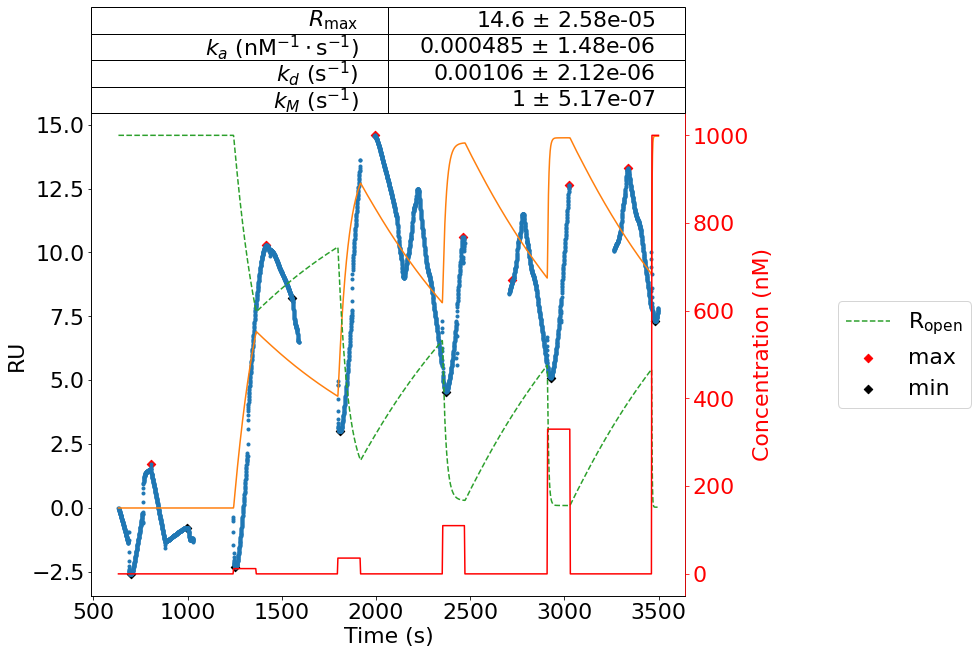

In [87]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt1_smoothed[:,1], height = 0, distance = 100, prominence = 5, width = 20, rel_height = 1)

# removing spikes based on the peaks located
Rt1_smoothed[:,1] = dc.spike_removal(Rt1_smoothed[:,1], peaks, thresh_v = -5, thresh_dv = 0, min_size = 50)

# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt1_smoothed[:,1], mask=np.isnan(Rt1_smoothed[:,1]))
indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM1 = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt1_smoothed), tC1, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results1 = ktit.fit_SPR( np.ma.masked_invalid(Rt1_smoothed), tC1, tinject, Rmax=resultsRM1.params['Rmax'].value, ka=resultsRM1.params['ka'].value, kd=resultsRM1.params['kd'].value)
fig, ax = plot_SPR_fit( Rt1_smoothed, tC1, tinject, results1.params, model='2C')

# showing peakutils maximas and minimas
ax.scatter( Rt_smoothed[:,0][indexes], Rt_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax.scatter( Rt_smoothed[:,0][neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min')
ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))

In [88]:
# poor experimental dataset
data = np.loadtxt("data/EGFR_WT_39596_full subtracted from Bioeval 05_19_2021.txt", skiprows = 1)
tC = np.loadtxt("data/EGFR_WT_tC_full_subtracted_39599_05_19_2021 from Bioeval.txt", skiprows = 1)

(-200.0, 200.0)

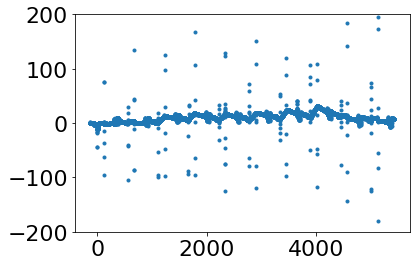

In [89]:
plt.plot(data[:,0], data[:,1], '.')
plt.ylim(-200,200)

In [90]:
Rt = data[:,:2]
Rt, outliers = ktit.remove_RU_outliers( Rt, zcut = 1.25)
m = interp1d([min(Rt[:,1]), max(Rt[:,1])], [0, max(Rt[:,1])- min(Rt[:,1])])
Rt[:,1] = m(Rt[:,1])
tinject = 120
resultsRM = ktit.fit_SPR_rapid_mixing( Rt, tC, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results = ktit.fit_SPR( Rt, tC, tinject, Rmax=resultsRM.params['Rmax'].value, ka=resultsRM.params['ka'].value, kd=resultsRM.params['kd'].value)

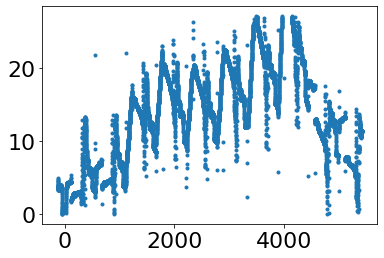

In [91]:
plt.plot(Rt[:,0], Rt[:,1], '.')

In [92]:
results # before data cleanup

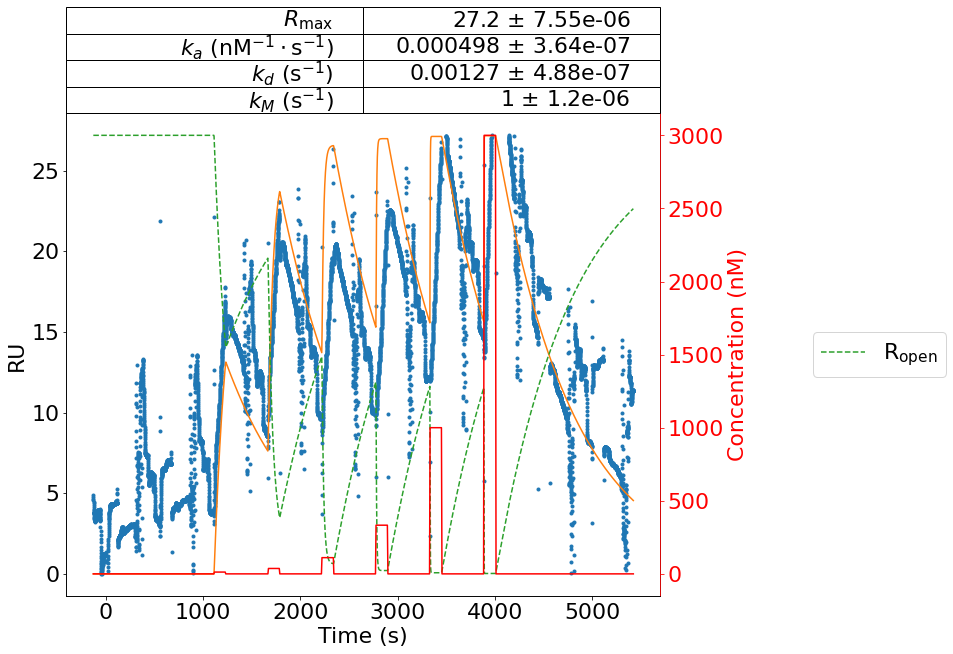

In [93]:
_ = plot_SPR_fit( Rt, tC, tinject, results.params, model='2C')

In [95]:
Rt_smoothed = copy.deepcopy(Rt)
# Rt_smoothed[:,1] = dc.IIR_smoothing(Rt[:,0], Rt[:,1], 200)
Rt_smoothed[:,1] = dc.SVG_filter(Rt_smoothed[:,0], Rt_smoothed[:,1], 109, 3)

interactive(children=(IntSlider(value=109, description='SVG Window size: ', max=499, min=5, step=2), Output())…

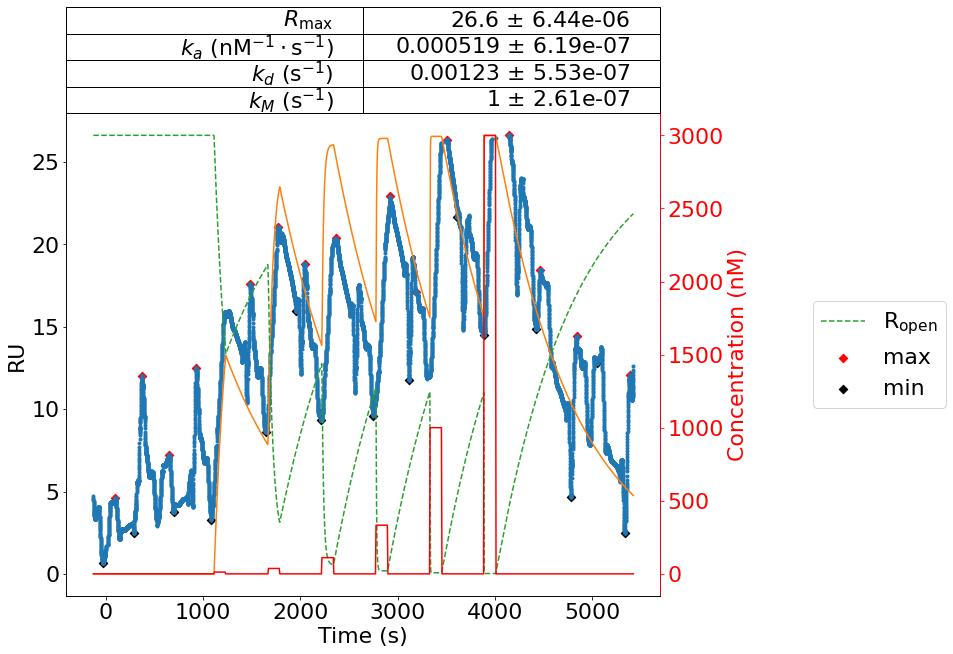

In [96]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt_smoothed[:,1], height = 0, distance = 100, prominence = 5, width = 20, rel_height = 1)

# # removing spikes based on the peaks located
# Rt_smoothed[:,1] = dc.spike_removal(Rt_smoothed[:,1], peaks, thresh_v = -5, thresh_dv = 0, min_size = 50)

# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt_smoothed[:,1], mask=np.isnan(Rt_smoothed[:,1]))
indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt_smoothed), tC, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results = ktit.fit_SPR( np.ma.masked_invalid(Rt_smoothed), tC, tinject, Rmax=resultsRM.params['Rmax'].value, ka=resultsRM.params['ka'].value, kd=resultsRM.params['kd'].value)
fig, ax = plot_SPR_fit( Rt_smoothed, tC, tinject, results.params, model='2C')

# showing peakutils maximas and minimas
ax.scatter( Rt_smoothed[:,0][indexes], Rt_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax.scatter( Rt_smoothed[:,0][neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min')
ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))

In [97]:
Rt1 = Rt[Rt[:,0]<3500,:]
tC1 = tC[tC[:,0]<3500,:]

In [98]:
resultsRM1 = ktit.fit_SPR_rapid_mixing( Rt1, tC1, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results1 = ktit.fit_SPR( Rt1, tC1, tinject, Rmax=resultsRM1.params['Rmax'].value, ka=resultsRM1.params['ka'].value, kd=resultsRM1.params['kd'].value)

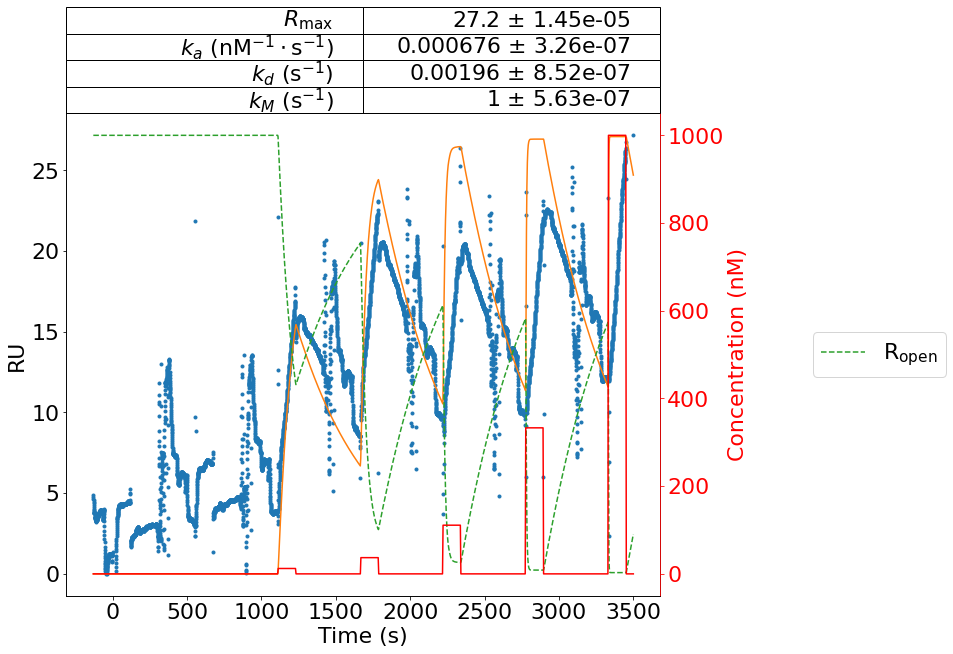

In [99]:
_ = plot_SPR_fit( Rt1, tC1, tinject, results1.params, model='2C')

In [100]:
Rt1_smoothed = copy.deepcopy(Rt1)
Rt1_smoothed[:,1] = dc.IIR_smoothing(Rt1_smoothed[:,0], Rt1_smoothed[:,1], 150)

interactive(children=(IntSlider(value=150, description='IIR Coefficient: ', max=500, min=1), Output()), _dom_c…

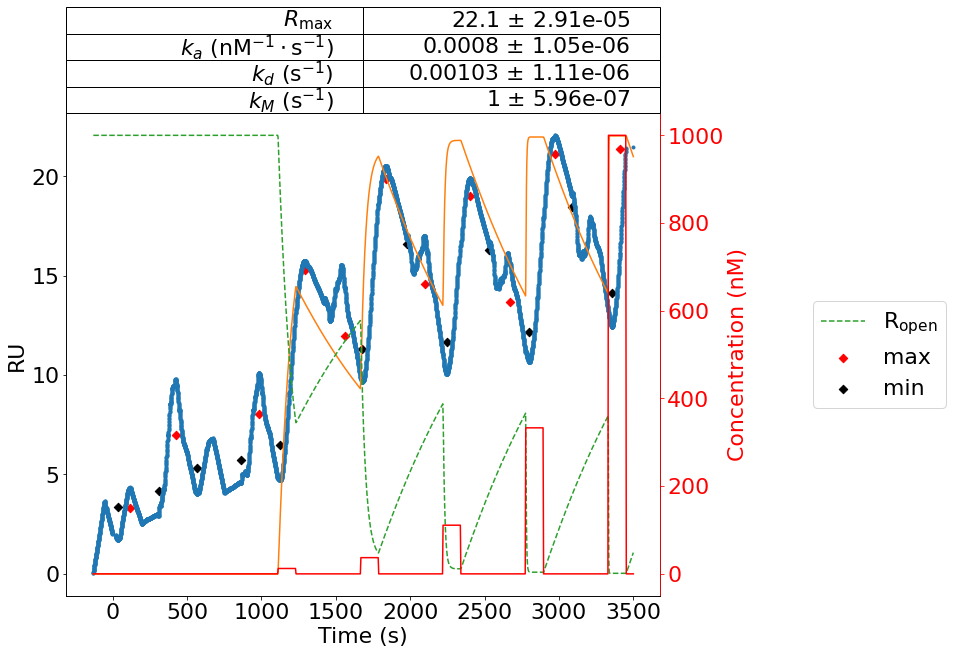

In [101]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt1_smoothed[:,1], height = 0, distance = 100, prominence = 5, width = 20, rel_height = 1)

# # removing spikes based on the peaks located
# Rt1_smoothed[:,1] = dc.spike_removal(Rt1_smoothed[:,1], peaks, thresh_v = -10, thresh_dv = 0, min_size = 50)

# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt1_smoothed[:,1], mask=np.isnan(Rt1_smoothed[:,1]))
indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM1 = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt1_smoothed), tC1, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results1 = ktit.fit_SPR( np.ma.masked_invalid(Rt1_smoothed), tC1, tinject, Rmax=resultsRM1.params['Rmax'].value, ka=resultsRM1.params['ka'].value, kd=resultsRM1.params['kd'].value)
fig, ax = plot_SPR_fit( Rt1_smoothed, tC1, tinject, results1.params, model='2C')

# showing peakutils maximas and minimas
ax.scatter( Rt_smoothed[:,0][indexes], Rt_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax.scatter( Rt_smoothed[:,0][neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min')
ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))

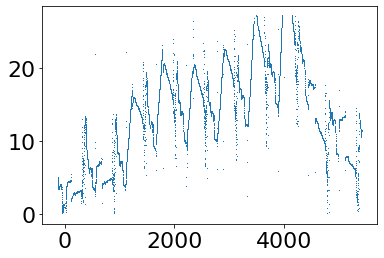

In [102]:
plt.plot(Rt[:,0], Rt[:,1], ',')

In [103]:
n = len(Rt)

In [104]:
tC[:,0]

array([ 555., 1111., 1666., 2220., 2776., 3331., 3887., 4442., 4997.])

In [105]:
import functools
tsyringe = 250
sel = functools.reduce( lambda x, y: np.logical_or( x, y), 
                 [ np.logical_and(Rt[:,0] >= tC[t,0], Rt[:,0]<(tC[t+1,0] - tsyringe)) for t in range(len(tC)-1) ])

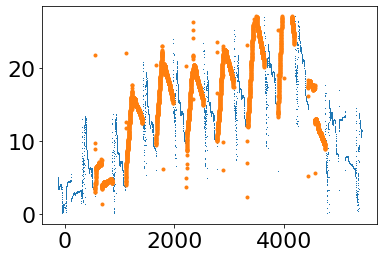

In [106]:
plt.plot( Rt[:,0], Rt[:,1], ',')
plt.plot( Rt[sel,0], Rt[sel,1], '.')

In [107]:
Rtp = Rt[sel,:]

In [108]:
tmax = 4000
Rtp, outliers = ktit.remove_RU_outliers( Rtp, zcut = 1.25)
Rt1 = Rtp[Rtp[:,0]<tmax,:]
tC1 = tC[tC[:,0]<tmax,:]
tinject = 120
resultsRM = ktit.fit_SPR_rapid_mixing( Rt1, tC1, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results = ktit.fit_SPR( Rt1, tC1, tinject, Rmax=resultsRM.params['Rmax'].value, ka=resultsRM.params['ka'].value, kd=resultsRM.params['kd'].value)

In [109]:
resultsRM # before data cleanup

In [110]:
results # before data cleanup

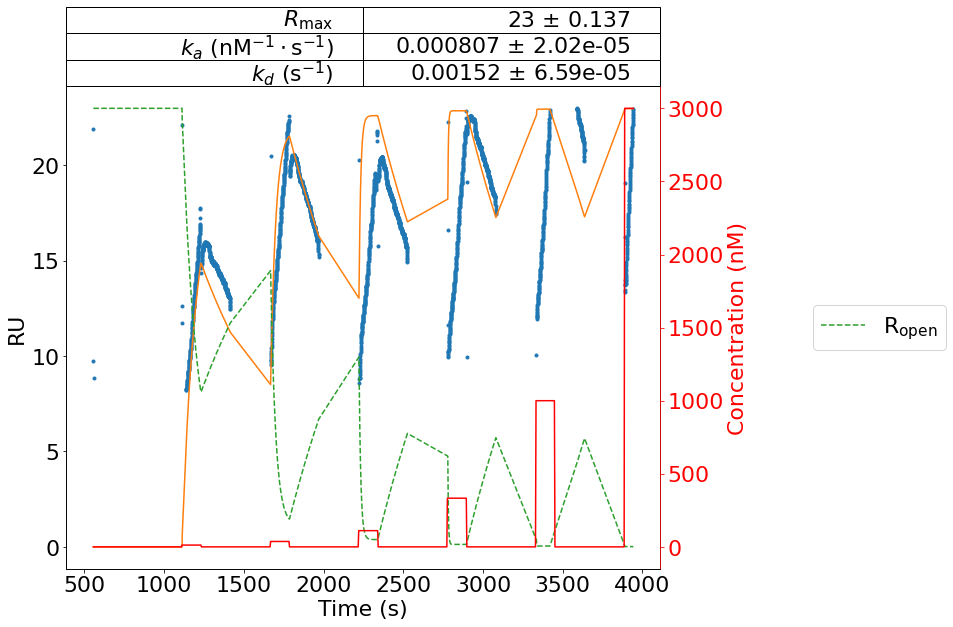

In [111]:
_ = plot_SPR_fit( Rt1, tC1, tinject, resultsRM.params, model='RM')

In [112]:
Rt1_smoothed = copy.deepcopy(Rt1)
Rt1_smoothed[:,1] = dc.IIR_smoothing(Rt1_smoothed[:,0], Rt1_smoothed[:,1], 10)
# Rt1_smoothed[:,1] = savgol_filter(Rt1_smoothed[:,1], 25, 3)

interactive(children=(IntSlider(value=10, description='IIR Coefficient: ', max=500, min=1), Output()), _dom_cl…

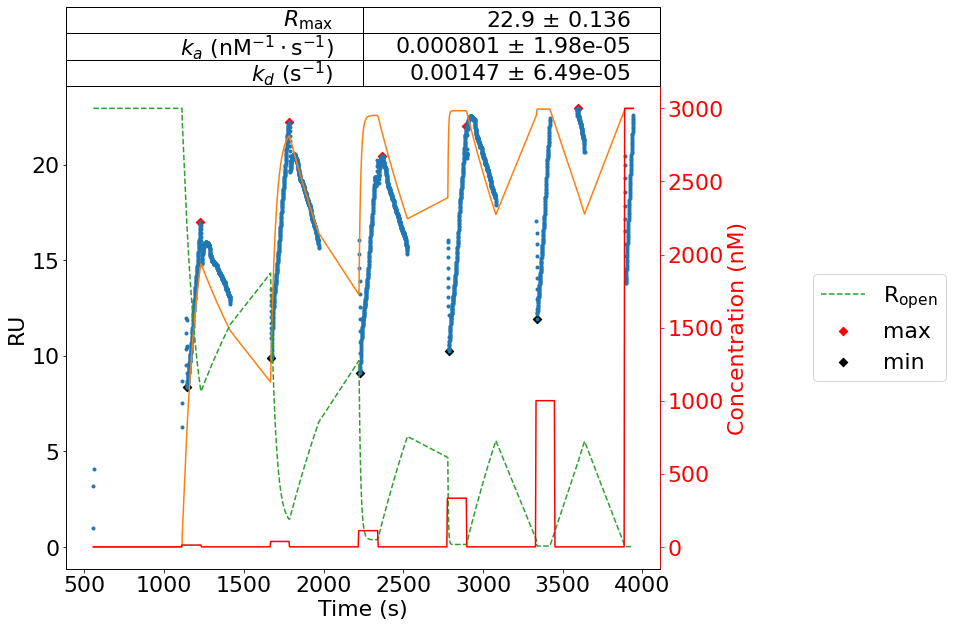

In [113]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt1_smoothed[:,1], height = 0, distance = 100, prominence = 5, width = 20, rel_height = 1)

# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt1_smoothed[:,1], mask=np.isnan(Rt1_smoothed[:,1]))
indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt1_smoothed), tC1, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
fig, ax = plot_SPR_fit( Rt1_smoothed, tC1, tinject, resultsRM.params, model='RM')

# showing peakutils maximas and minimas
ax.scatter( Rt1_smoothed[:,0][indexes], Rt1_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax.scatter( Rt1_smoothed[:,0][neg_indexes], Rt1_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min')
ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))

In [114]:
# latest experimental dataset that's supposedly good 
data = np.loadtxt("data/KRAS_G12D_40027.txt", skiprows = 1)
tC = np.loadtxt("data/KRAS_tC_G12D_40027.txt", skiprows = 1)

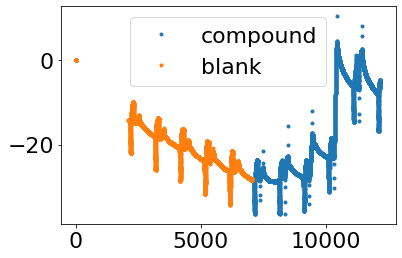

In [115]:
plt.plot(data[:,0], data[:,1], '.', label = "compound")
plt.plot(data[:,2], data[:,3], '.', label = 'blank')
plt.legend(loc='best')

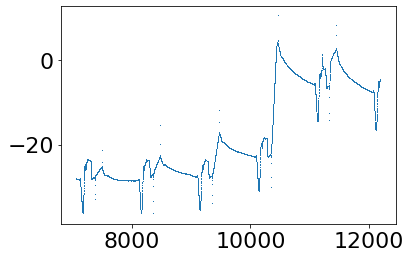

In [116]:
plt.plot(data[:,0], data[:,1], ',')

In [117]:
Rt = data[:,:2]
Rt, outliers = ktit.remove_RU_outliers(Rt, zcut=2.5)
tinject = 120
m = interp1d([min(Rt[:,1]), max(Rt[:,1])], [0, max(Rt[:,1])- min(Rt[:,1])])
Rt[:,1] = m(Rt[:,1])
resultsRM = ktit.fit_SPR_rapid_mixing( Rt, tC, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results = ktit.fit_SPR( Rt, tC, tinject, Rmax=resultsRM.params['Rmax'].value, ka=resultsRM.params['ka'].value, kd=resultsRM.params['kd'].value)

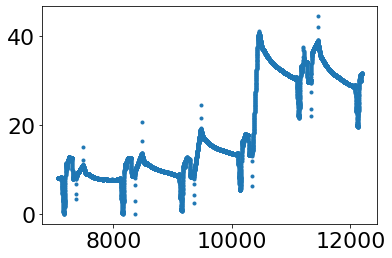

In [118]:
plt.plot( Rt[:,0], Rt[:,1], '.')

In [119]:
resultsRM # prior to data cleanup of Rt values

In [120]:
results # prior to data cleanup of Rt values

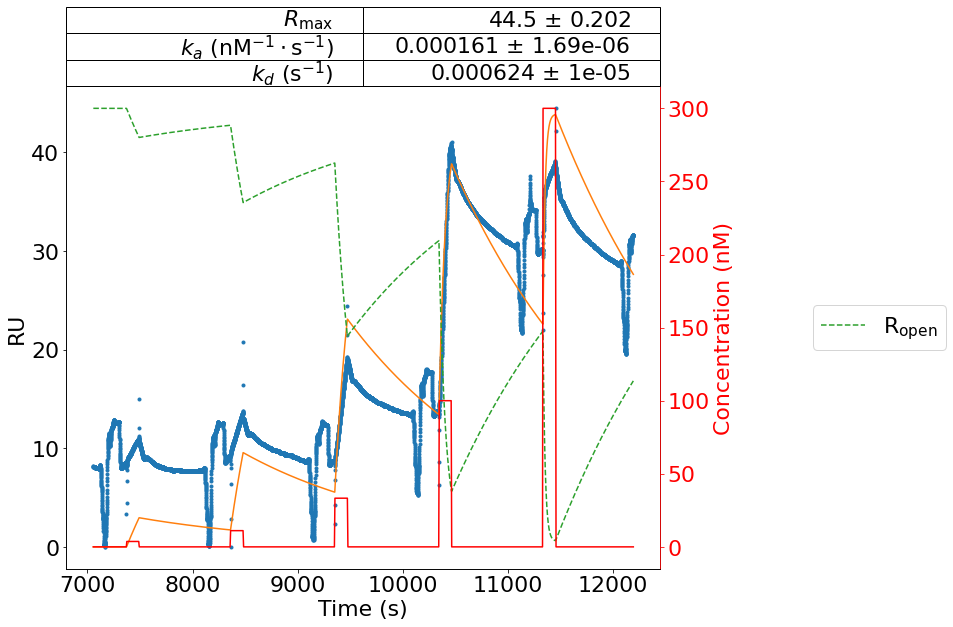

In [121]:
fig, ax = plot_SPR_fit( Rt, tC, tinject, resultsRM.params, model='RM')

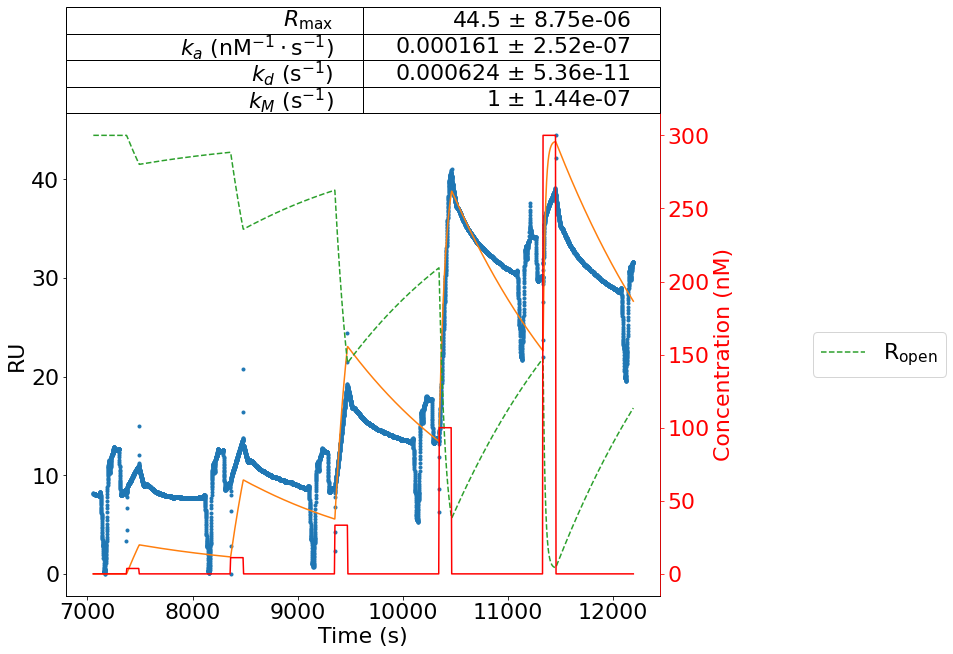

In [122]:
fig, ax = plot_SPR_fit( Rt, tC, tinject, results.params, model='2C')

In [123]:
Rt_smoothed = copy.deepcopy(Rt)
Rt_smoothed[:,1] = dc.IIR_smoothing( Rt_smoothed[:,0], Rt_smoothed[:,1], 300)
#Rt_smoothed[:,1] = dc.SVG_filter( Rt_smoothed[:,0], Rt_smoothed[:,1], 99, 3)

interactive(children=(IntSlider(value=300, description='IIR Coefficient: ', max=500, min=1), Output()), _dom_c…

/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in less
  & (np.greater(y, thres))
/Users/chrislanyx/anaconda3/lib/python3.7/site-packages/peakutils/peak.py:87: RuntimeWarning: invalid value encountered in greater
  & (np.greater(y, thres))


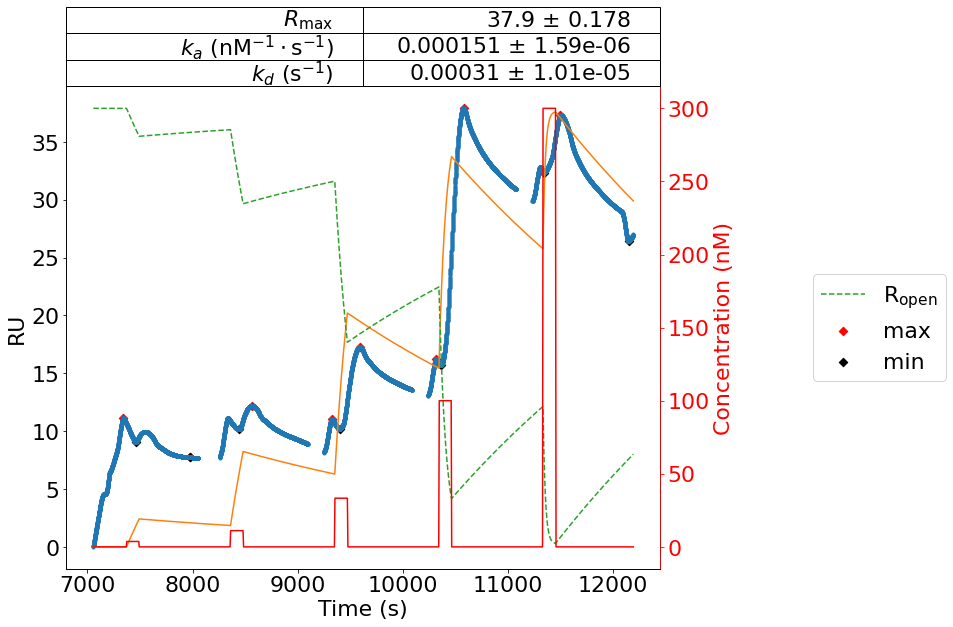

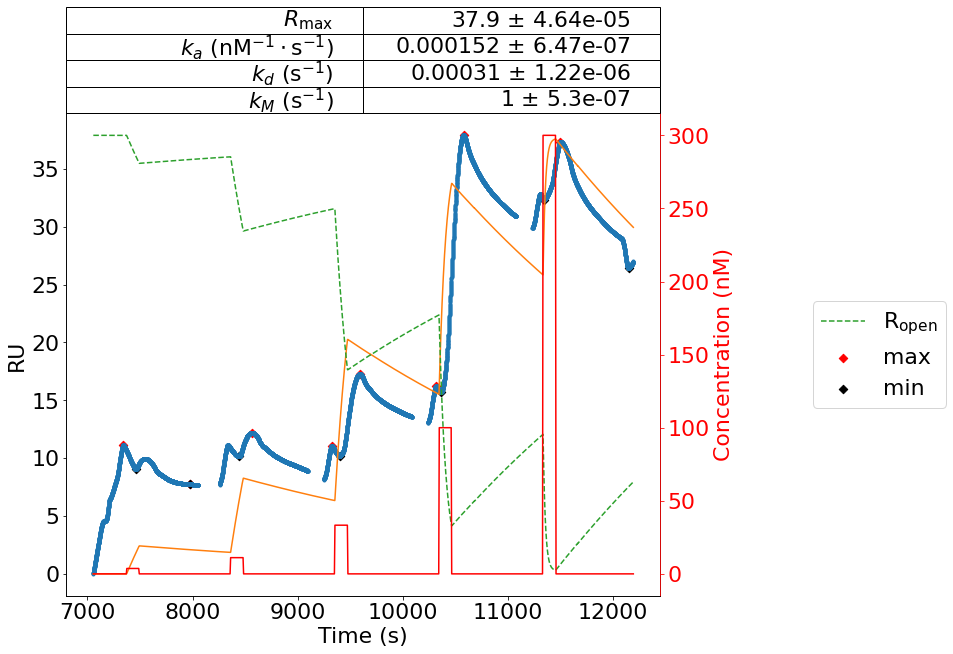

In [125]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt_smoothed[:,1], height = 0, distance = 100, prominence = 5, width = 20, rel_height = 1)
mirrored_rt = -1*Rt_smoothed[:,1]
minima_rt, minima_properties = dc.peak_detection_scipy(mirrored_rt, distance = 500, prominence = 5, rel_height = 1)
ax.scatter( Rt[:,0][minima_rt], -1*mirrored_rt[minima_rt], color = 'k', marker = 'D', label = 'spike$_\mathrm{maxima}$')

# removing spikes based on the peaks located
Rt_smoothed[:,1] = dc.spike_removal(Rt_smoothed[:,1], minima_rt, thresh_v = -5, thresh_dv = 0, min_size = 150)

# detecting binding start and end phases in processed data
RU_masked = np.ma.array(Rt_smoothed[:,1], mask=np.isnan(Rt_smoothed[:,1]))
indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt_smoothed), tC, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
results = ktit.fit_SPR( np.ma.masked_invalid(Rt_smoothed), tC, tinject, Rmax=resultsRM.params['Rmax'].value, ka=resultsRM.params['ka'].value, kd=resultsRM.params['kd'].value)
fig, ax = plot_SPR_fit( Rt_smoothed, tC, tinject, resultsRM.params, model='RM')
fig1, ax1 = plot_SPR_fit( Rt_smoothed, tC, tinject, results.params, model='2C')

# showing peakutils maximas and minimas
ax.scatter( Rt_smoothed[:,0][indexes], Rt_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax.scatter( Rt_smoothed[:,0][neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min')
ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))
ax1.scatter( Rt_smoothed[:,0][indexes], Rt_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
ax1.scatter( Rt_smoothed[:,0][neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min')
ax1.legend( loc='right', bbox_to_anchor = (1.5,0.5))

In [126]:
resultsRM # after processing

In [127]:
results

In [128]:
# same raw experimental dataset, but processed after Bioevaluation software
data = np.loadtxt("data/Bioeval fit of 40027 binding to KRAS G12D GDP 06_25_21.txt", skiprows = 1, usecols=(0,1))
tC = np.loadtxt("data/Bioeval fit of 40027 binding to KRAS G12D GDP 06_25_21_conc", skiprows = 1)

(0.0, 64.416005)

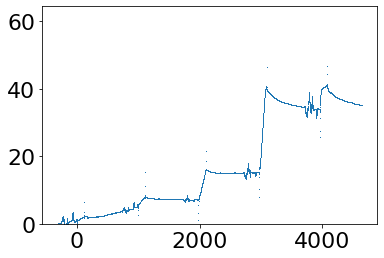

In [129]:
plt.plot(data[:,0], data[:,1], ',')
plt.ylim(bottom = 0)

In [130]:
Rt = data[:,:2]
Rt, outliers = ktit.remove_RU_outliers(Rt, zcut=1.25)
tinject = 120
m = interp1d([min(Rt[:,1]), max(Rt[:,1])], [0, max(Rt[:,1])- min(Rt[:,1])])
Rt[:,1] = m(Rt[:,1])
resultsRM = ktit.fit_SPR_rapid_mixing( Rt, tC, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)

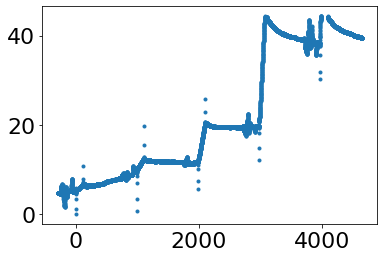

In [131]:
plt.plot( Rt[:,0], Rt[:,1], '.')

In [132]:
resultsRM

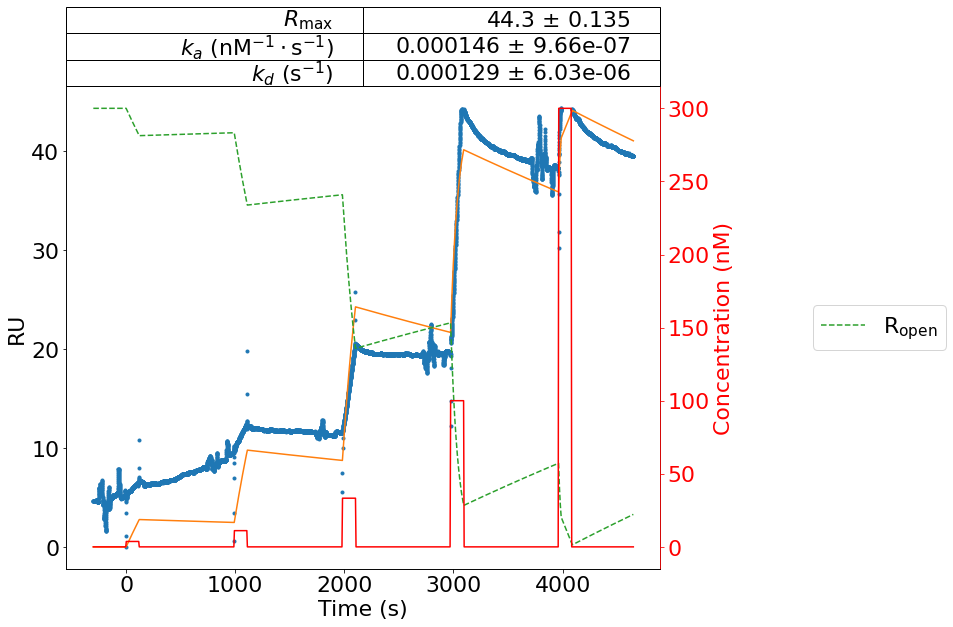

In [133]:
fig, ax = plot_SPR_fit( Rt, tC, tinject, resultsRM.params, model='RM')

In [136]:
Rt_smoothed = copy.deepcopy(Rt)
# Rt_smoothed[:,1] = dc.IIR_smoothing(Rt[:,0],Rt[:,1], 40)
Rt_smoothed[:,1] = dc.SVG_filter(Rt_smoothed[:,0], Rt_smoothed[:,1], 27, 3)

interactive(children=(IntSlider(value=27, description='SVG Window size: ', max=499, min=5, step=2), Output()),…

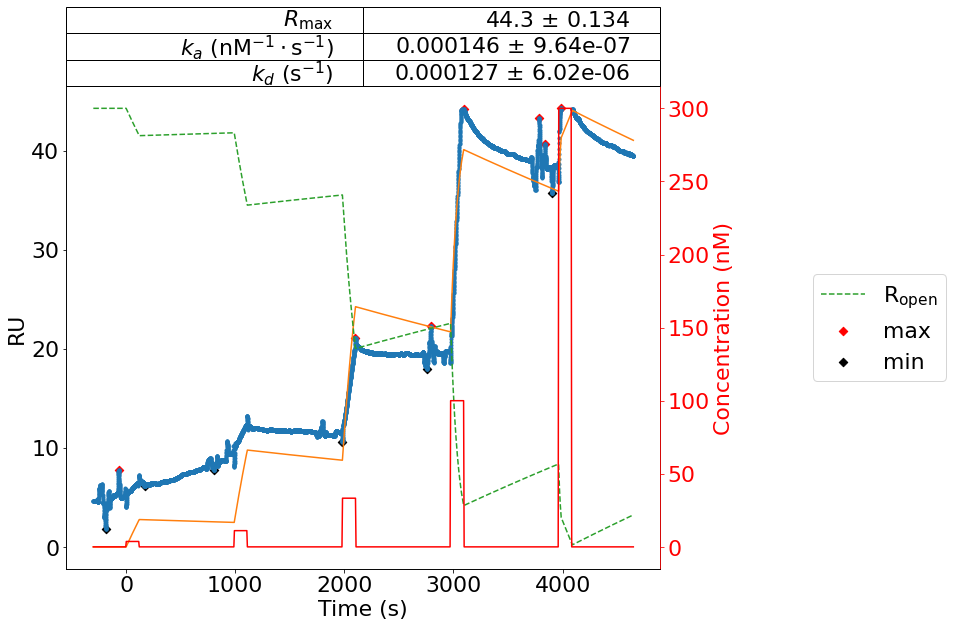

In [137]:
# finding peaks in Rt curve using find_peaks from scipy library
peaks, properties = dc.peak_detection_scipy(Rt_smoothed[:,1], height = 0, distance = 100, prominence = 3)
mirrored_rt = -1*Rt_smoothed[:,1]
minima_rt, minima_properties = dc.peak_detection_scipy(mirrored_rt, distance = 500, prominence = 1)

# # removing spikes based on the peaks located
# Rt_smoothed[:,1] = dc.spike_removal(Rt_smoothed[:,1], minima_rt, thresh_v = 0, thresh_dv = 0, min_size = 100)

# # detecting binding start and end phases in processed data
# RU_masked = np.ma.array(Rt_smoothed[:,1], mask=np.isnan(Rt_smoothed[:,1]))
# indexes = dc.peakutils_detection(RU_masked, thres=0.1/max(RU_masked), min_dist=500)
# neg_indexes = dc.peakutils_detection(-1*RU_masked, thres=0.1/max(-1*RU_masked), min_dist=500)

# smoothing and spiked removed Rt data fitting and plotting
resultsRM = ktit.fit_SPR_rapid_mixing( np.ma.masked_invalid(Rt_smoothed), tC, tinject, Rmax=1000., ka=1.e-4, kd=1.e-3)
fig, ax = plot_SPR_fit( Rt_smoothed, tC, tinject, resultsRM.params, model='RM')

# showing peakutils maximas and minimas
# ax.scatter( Rt_smoothed[:,0][indexes], Rt_smoothed[:,1][indexes], color = 'r', marker = 'D', label = 'max') 
# ax.scatter( Rt_smoothed[:,0][neg_indexes], Rt_smoothed[:,1][neg_indexes], color = 'k', marker = 'D', label = 'min')
ax.scatter( Rt_smoothed[:,0][peaks], properties['peak_heights'], color = 'r', marker = 'D', label = 'max')
ax.scatter( Rt_smoothed[:,0][minima_rt], -1*mirrored_rt[minima_rt], color = 'k', marker = 'D', label = 'min')
ax.legend( loc='right', bbox_to_anchor = (1.5,0.5))